In [5]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

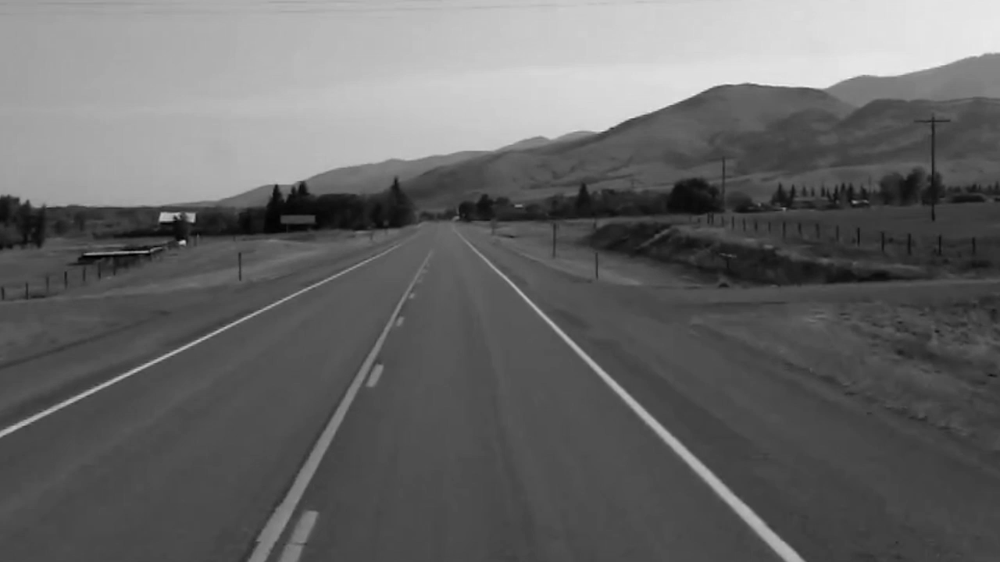

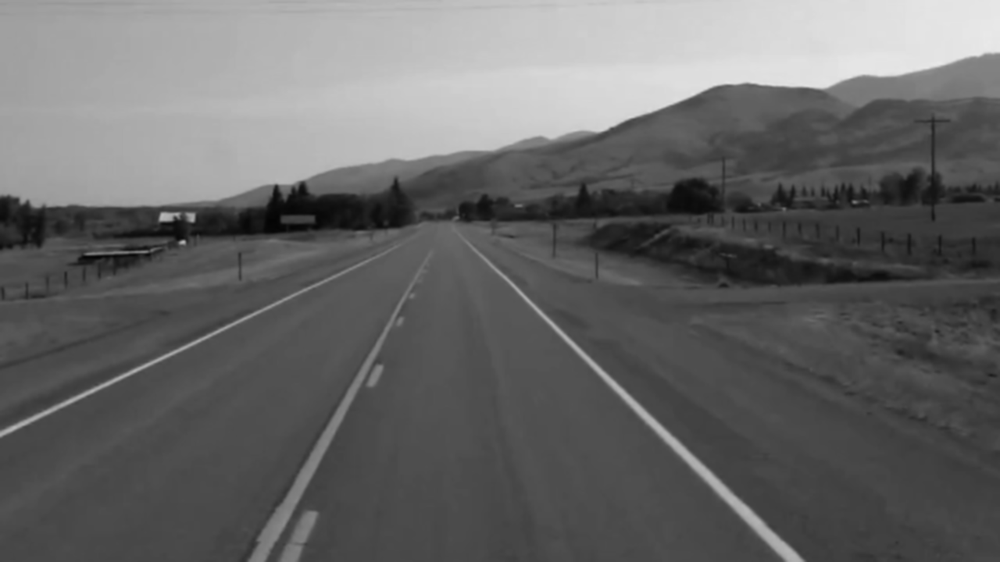

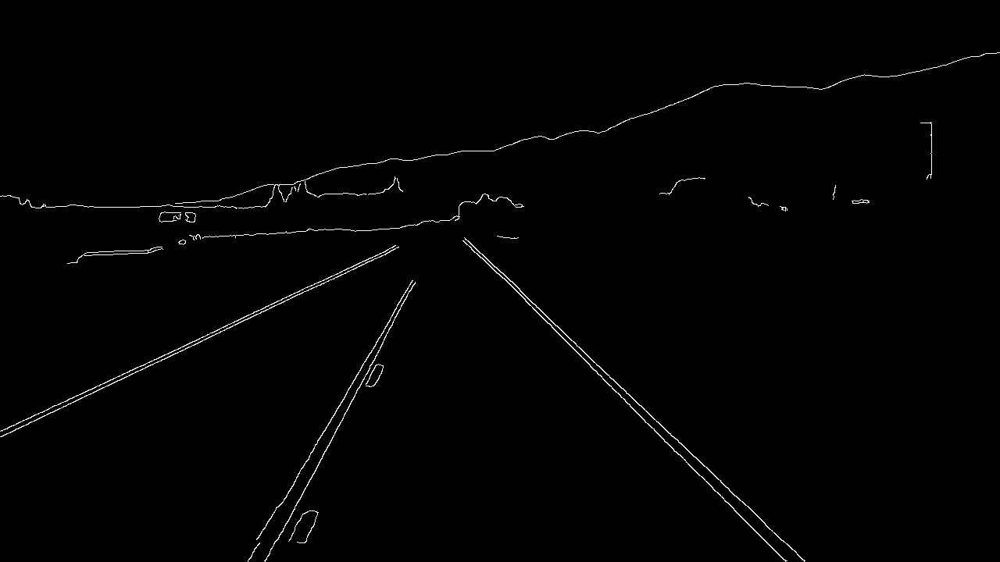

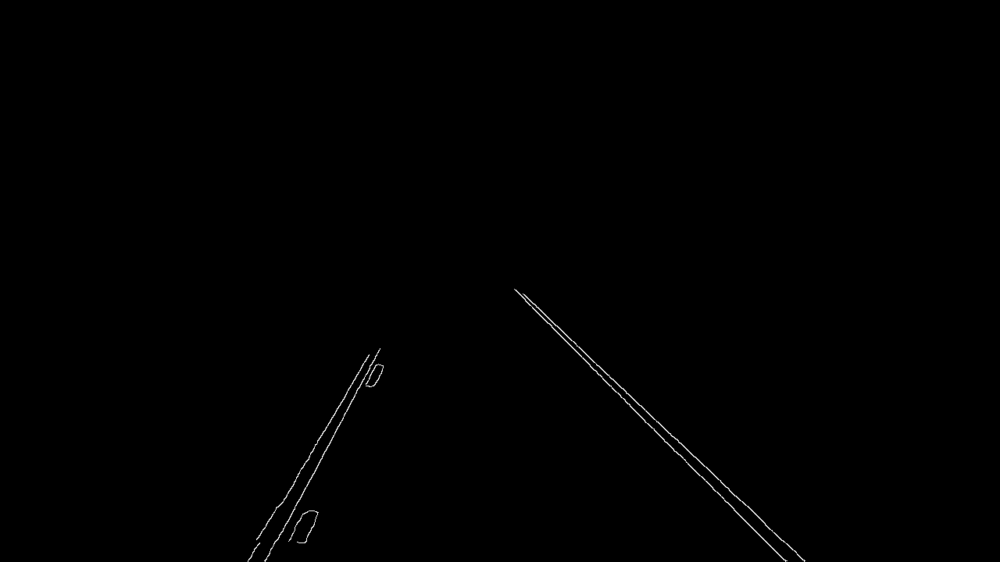

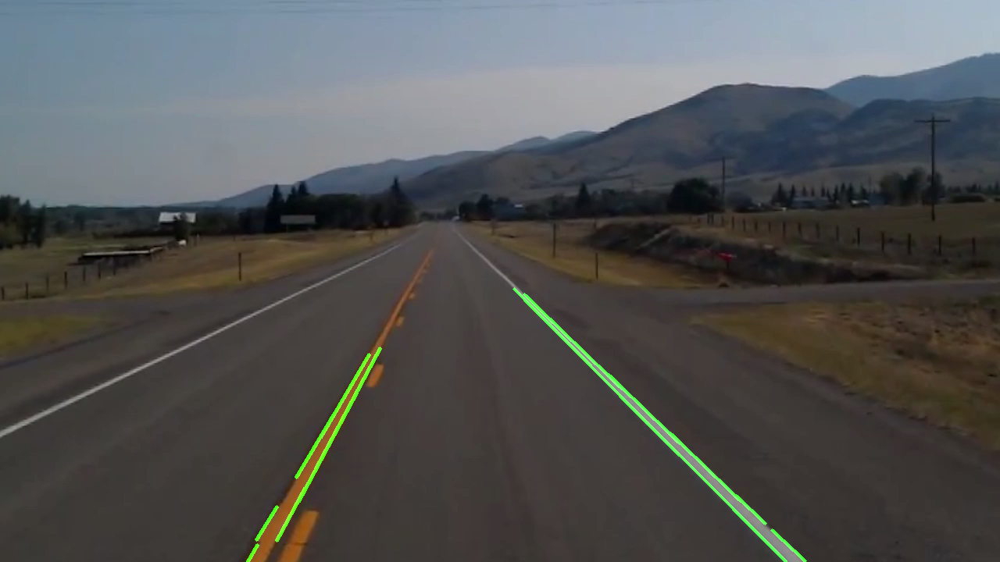

...

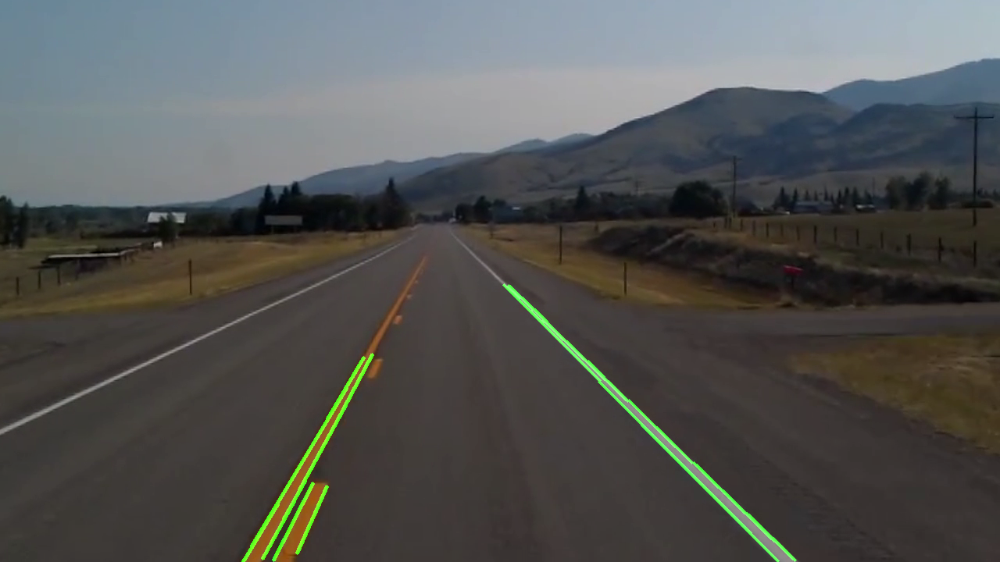

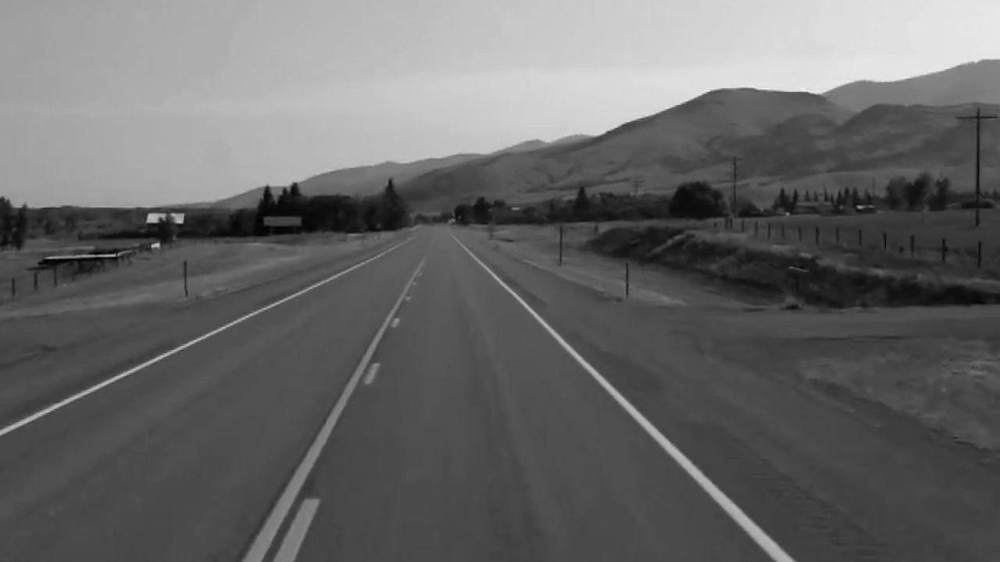

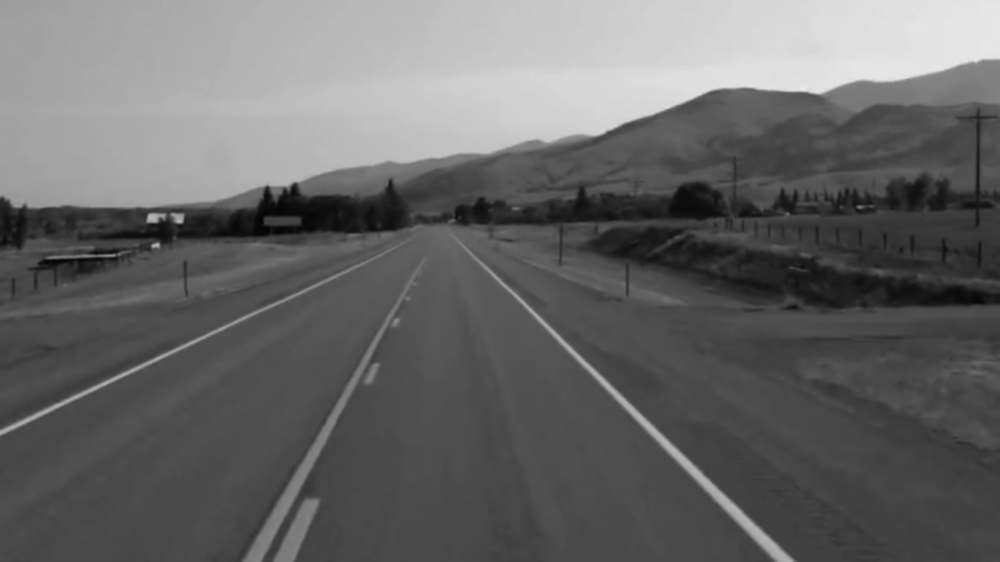

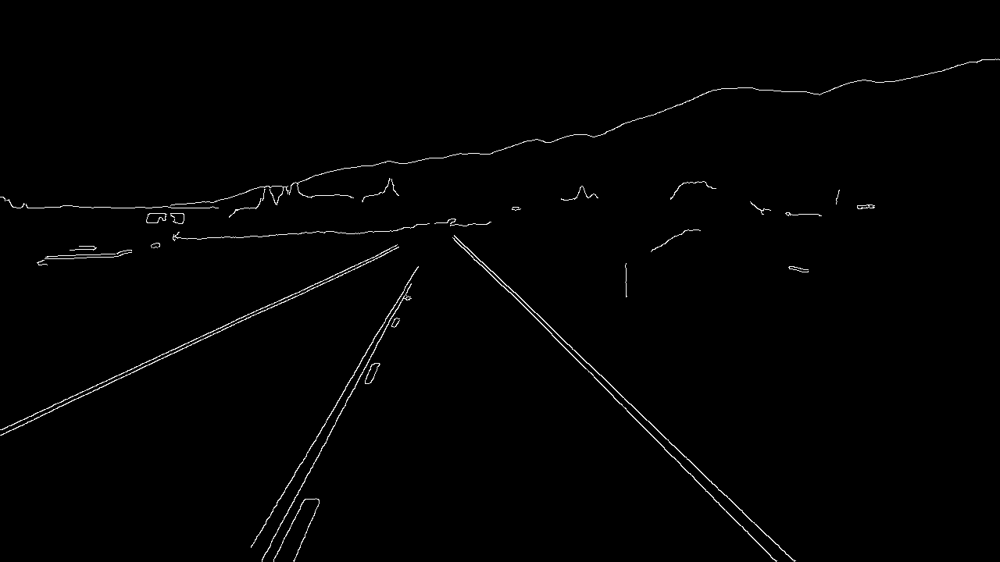

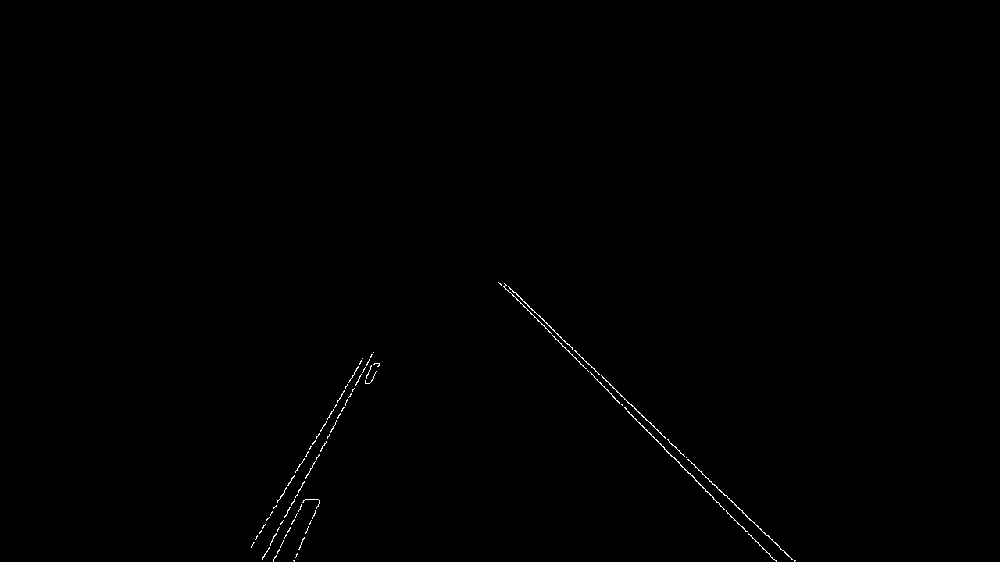

In [ ]:
# Function to apply region of interest mask
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)
    cv2.fillPoly(mask, vertices, 255)
    masked_img = cv2.bitwise_and(img, mask)
    return masked_img

# Function to draw lines on the image
def draw_lines(img, lines, color=(0, 255, 0), thickness=3):
    for line in lines:
        for x1, y1, x2, y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

# Load the video
cap = cv2.VideoCapture('test_video.mp4')

# Define the codec and create a VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output_video.mp4', fourcc, 30, (int(cap.get(3)), int(cap.get(4))))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert the frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Display the grayscale frame
    cv2_imshow(gray)

    # Apply Gaussian blur
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Display the blurred frame
    cv2_imshow(blurred)

    # Apply Canny edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Display the edges frame
    cv2_imshow(edges)

    # Define region of interest
    height, width = edges.shape
    vertices = np.array([[(0, height), (width/2, height/2), (width, height)]], dtype=np.int32)
    roi = region_of_interest(edges, vertices)

    # Display the region of interest
    cv2_imshow(roi)

    # Apply Hough Transform to detect lines
    lines = cv2.HoughLinesP(roi, 1, np.pi/180, 50, np.array([]), minLineLength=8, maxLineGap=4)

    if lines is not None:
        line_img = np.zeros_like(frame)
        draw_lines(line_img, lines)
        result = cv2.addWeighted(frame, 0.8, line_img, 1, 0)

        # Display the result with detected lines
        cv2_imshow(result)

        # Write the frame to the output video
        out.write(result)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the VideoWriter and close windows
out.release()
cap.release()
cv2.destroyAllWindows()